In [49]:
import pandas as pd
import torch
import matplotlib.pyplot as plt
import numpy as np
from torch.autograd import Variable
from sklearn.metrics import mean_squared_error as mse

In [50]:
# last_winter_period = (0, 24*90)
# spring_period = (24*90, 24*180)
# summer_period = (24*180, 24*270)
# autumn_period = (24*210, 24*360)

In [51]:
df = pd.read_csv('Data.csv')

In [52]:
df

,Unnamed: 0,Date/Time,T_ext,Electricity,DistrictCooling,DistrictHeating,DHI,DNI,Wind_Speed,Wind_Direction,...,Tin_CLASSD,Tin_OFFICEA,Tin_OFFICEB,Tin_TOILETC,Tin_TOILETB,Tin_RECEPTION,T_in_aver,Total Energy Consumption,hour,is_weekday
0,0,1104541200,14.200,0.126597,0.0,0.0,0.0,0.0,1.250,172.50,...,23.532259,26.125828,25.848793,24.808569,21.791067,22.511210,23.558251,0.126597,0,0
1,1,1104544800,14.125,0.126597,0.0,0.0,0.0,0.0,1.025,164.75,...,23.390209,25.902964,25.653694,24.703885,21.732944,22.408774,23.431051,0.126597,1,0
2,2,1104548400,13.625,0.126597,0.0,0.0,0.0,0.0,0.750,193.50,...,23.173372,25.642189,25.419295,24.568652,21.626084,22.248008,23.246617,0.126597,2,0
3,3,1104552000,13.275,0.126597,0.0,0.0,0.0,0.0,0.850,249.75,...,22.982800,25.401733,25.203407,24.441714,21.536341,22.099309,23.082154,0.126597,3,0
4,4,1104555600,13.050,0.126597,0.0,0.0,0.0,0.0,0.900,229.75,...,22.808300,25.179677,25.004449,24.325237,21.456220,21.961348,22.931769,0.126597,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8755,8755,1136059200,11.225,0.126597,0.0,0.0,0.0,0.0,2.300,204.25,...,19.028997,20.720960,20.829082,21.174118,19.235847,18.792202,19.500498,0.126597,19,0
8756,8756,1136062800,10.875,0.126597,0.0,0.0,0.0,0.0,1.625,129.00,...,18.914675,20.591834,20.707566,21.047885,19.123752,18.653635,19.380085,0.126597,20,0
8757,8757,1136066400,10.425,0.126597,0.0,0.0,0.0,0.0,0.675,152.25,...,18.794134,20.453726,20.575746,20.907922,19.009278,18.511635,19.253303,0.126597,21,0
8758,8758,1136070000,9.925,0.126597,0.0,0.0,0.0,0.0,0.250,163.50,...,18.655482,20.307011,20.435474,20.777710,18.891361,18.356866,19.116707,0.126597,22,0


In [53]:
#input data
# inputdata = 

In [108]:
x_col_names = [
    'hour',
    'is_weekday',
    'T_ext',
    'T_in_aver',
    'DNI',
#     'DHI',
#     'Wind_Speed',
#     'Wind_Direction',
    # 'Electricity',
    'DistrictCooling',
    # 'DistrictHeating',
]
y_col_names = [
    'Electricity',
    # 'DistrictCooling',
    # 'DistrictHeating',
    # 'T_in_aver'
]

In [109]:
def to_variable(x):
    tmp = torch.FloatTensor(x)
    return Variable(tmp)

In [110]:
hidden_size = 10
batch_size = 1
input_size = len(x_col_names)
final_output_size = len(y_col_names)
learning_rate = 0.001
# print(len(df))
assert len(df) % batch_size == 0

In [111]:
seq_len = len(df) // batch_size
# lstm = torch.nn.LSTM(input_size=len(x_col_names), hidden_size=hidden_size)
input = np.array(df[x_col_names])
input = torch.FloatTensor(input.reshape((seq_len, batch_size, input_size)))
print(len(input))
y_train = np.array(df[y_col_names]).reshape((-1, batch_size, final_output_size))

8760


In [112]:
# input = torch.randn(1, batch_size, len(x_col_names))
# h0 = torch.randn(1, batch_size, hidden_size)
# c0 = torch.randn(1, batch_size, hidden_size)
# output = lstm(input, (h0, c0))
# regress = torch.nn.Linear(hidden_size, len(y_col_names))
hidden_neuron_num = 15

In [113]:
class LSTMPred(torch.nn.Module):
    def __init__(self, input_size, hidden_size, batch_size, final_output_size):
        super(LSTMPred, self).__init__()

        self.lstm = torch.nn.LSTM(input_size=input_size, hidden_size=hidden_size)

        self.dense = torch.nn.Sequential(
            torch.nn.Linear(hidden_size, hidden_neuron_num),
            torch.nn.ReLU(),
            torch.nn.Linear(hidden_neuron_num, final_output_size)  
        )
        self.h = torch.randn(1, batch_size, hidden_size)
        self.c = torch.randn(1, batch_size, hidden_size)

    def forward(self, x):  
        lstm_out, (h, c) = self.lstm(x, (self.h, self.c))  
        dense_out = self.dense(lstm_out.view(len(x), -1))
        return dense_out

In [114]:
model = LSTMPred(input_size, hidden_size, batch_size, final_output_size)
loss_f = torch.nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

In [115]:
for epoch in range(30):
    print(f'epoch: {epoch}')
    for i in range(900, 1500 - 1):
        seq = input[i:i+batch_size]
        print(seq.size())
        seq = seq.view(len(seq), batch_size, input_size)
        print(f'seq.shape: {seq.shape}')

        y_test = torch.FloatTensor(y_train[i + 1].reshape(-1, 1))

        optimizer.zero_grad()
        y_hat = model(seq)
        y_hat = y_hat.view(-1, 1)

        # print(y_hat.shape)
        # print(y_test.shape)

        loss = loss_f(y_hat, y_test)
        loss.backward()
        optimizer.step()
        print(loss)

epoch: 0
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(109.1078, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(108.9343, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(110.7647, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(131.3064, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(221.0385, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(57.3761, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(4.9757, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(4.9282, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0590, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0511, grad_fn=<MseLossBackward0>)


In [116]:
# torch.save(model, 'lstm_model.pth')

In [117]:
y_pred = []
for i in range(1500, 1668, 1):
    seq = input[i]
    seq = seq.view(len(seq), batch_size, input_size)
    # y_test = torch.FloatTensor(y_train[i + 1].reshape(-1))
    y_hat = model(seq)

    y_pred.append((y_hat.view(-1)).detach().numpy())

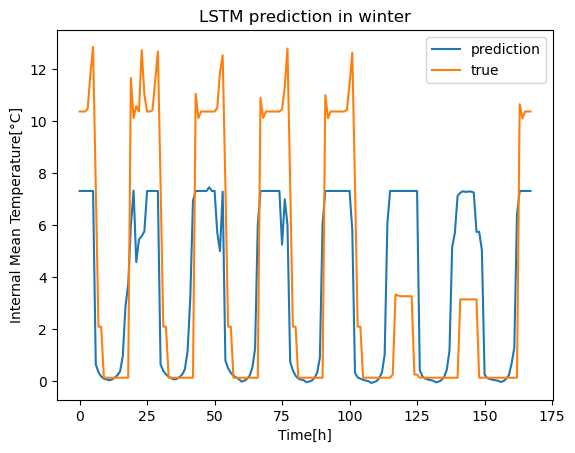

In [118]:
y_pred = np.array(y_pred)
y_pred = y_pred.reshape(-1)
plt.figure()
plt.plot(y_pred, label='prediction')
plt.plot(range(len(y_pred)),df.loc[1500:1668-1, y_col_names], label='true')
plt.xlabel('Time[h]')
plt.ylabel('Internal Mean Temperature[°C]')
plt.legend()
plt.title('LSTM prediction in winter')
plt.show()

In [119]:
y_real_winter = df.loc[1500:1668-1, y_col_names]

In [135]:
print(f'mse:{mse(y_real_winter, y_pred)}')

mse:15.386719766885795


In [121]:
for epoch in range(30):
    print(f'epoch: {epoch}')
    for i in range(4400, 5000 - 1):
        seq = input[i:i+batch_size]
        print(seq.size())
        seq = seq.view(len(seq), batch_size, input_size)
        print(f'seq.shape: {seq.shape}')

        y_test = torch.FloatTensor(y_train[i + 1].reshape(-1, 1))

        optimizer.zero_grad()
        y_hat = model(seq)
        y_hat = y_hat.view(-1, 1)

        # print(y_hat.shape)
        # print(y_test.shape)

        loss = loss_f(y_hat, y_test)
        loss.backward()
        optimizer.step()
        print(loss)

epoch: 0
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(21.0450, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(35.5041, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(34.3785, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(34.9646, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(37.1527, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(39.9031, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(40.6022, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(37.0736, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(5.7289, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(29.5543, grad_fn=<MseLossBackward0>)
to

In [122]:
y_pred = []
for i in range(5000, 5168, 1):
    seq = input[i]
    seq = seq.view(len(seq), batch_size, input_size)
    # y_test = torch.FloatTensor(y_train[i + 1].reshape(-1))
    y_hat = model(seq)

    y_pred.append((y_hat.view(-1)).detach().numpy())

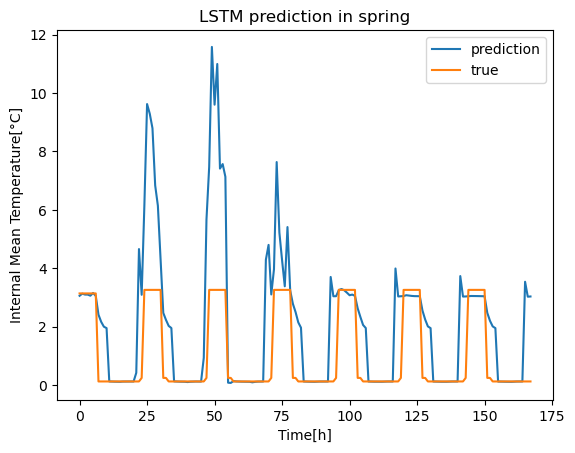

In [123]:
y_pred = np.array(y_pred)
y_pred = y_pred.reshape(-1)
plt.figure()
plt.plot(y_pred, label='prediction')
plt.plot(range(len(y_pred)),df.loc[5000:5168
                                   -1, y_col_names], label='true')
plt.xlabel('Time[h]')
plt.ylabel('Internal Mean Temperature[°C]')
plt.legend()
plt.title('LSTM prediction in spring')
plt.show()

In [124]:
y_pred.shape

(168,)

In [125]:
y_real_spring = df.loc[5000:5168-1, y_col_names]

In [126]:
print(f'mse:{mse(y_real_spring, y_pred)}')

mse:4.344282862567802


In [127]:
for epoch in range(10):
    print(f'epoch: {epoch}')
    for i in range(5500 - 1):
        seq = input[i:i+batch_size]
        print(seq.size())
        seq = seq.view(len(seq), batch_size, input_size)
        print(f'seq.shape: {seq.shape}')

        y_test = torch.FloatTensor(y_train[i + 1].reshape(-1, 1))

        optimizer.zero_grad()
        y_hat = model(seq)
        y_hat = y_hat.view(-1, 1)

        # print(y_hat.shape)
        # print(y_test.shape)

        loss = loss_f(y_hat, y_test)
        loss.backward()
        optimizer.step()
        print(loss)

epoch: 0
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0052, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0009, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(2.5962e-06, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0003, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0006, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0006, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0004, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0627, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.4750, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.3657, grad_fn=<MseLossBackward0>)
torch.S

In [128]:
y_pred = []
for i in range(5500, 5668, 1):
    seq = input[i]
    seq = seq.view(len(seq), batch_size, input_size)
    # y_test = torch.FloatTensor(y_train[i + 1].reshape(-1))
    y_hat = model(seq)

    y_pred.append((y_hat.view(-1)).detach().numpy())

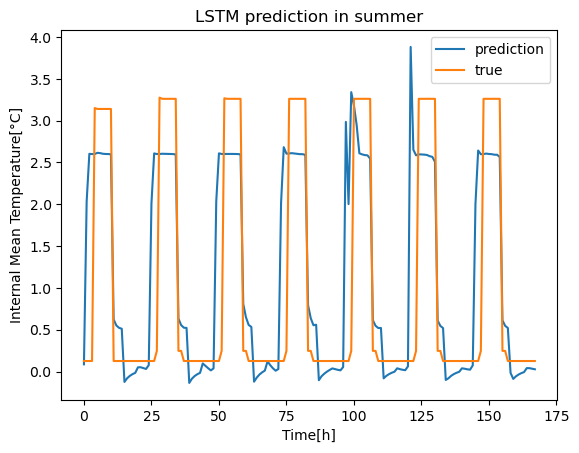

In [129]:
y_pred = np.array(y_pred)
y_pred = y_pred.reshape(-1)
plt.figure()
plt.plot(y_pred, label='prediction')
plt.plot(range(len(y_pred)),df.loc[5500:5668-1, y_col_names], label='true')
plt.xlabel('Time[h]')
plt.ylabel('Internal Mean Temperature[°C]')
plt.legend()
plt.title('LSTM prediction in summer')
plt.show()

In [130]:
y_pred.shape
y_real_summer = df.loc[5500:5668-1, y_col_names]
print(f'mse:{mse(y_real_summer, y_pred)}')

mse:0.8946285782061901


In [131]:
for epoch in range(10):
    print(f'epoch: {epoch}')
    for i in range(7000 - 1):
        seq = input[i:i+batch_size]
        print(seq.size())
        seq = seq.view(len(seq), batch_size, input_size)
        print(f'seq.shape: {seq.shape}')

        y_test = torch.FloatTensor(y_train[i + 1].reshape(-1, 1))

        optimizer.zero_grad()
        y_hat = model(seq)
        y_hat = y_hat.view(-1, 1)

        # print(y_hat.shape)
        # print(y_test.shape)

        loss = loss_f(y_hat, y_test)
        loss.backward()
        optimizer.step()
        print(loss)

epoch: 0
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0127, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0017, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0005, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0018, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.0616, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(2.0895, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(7.0902, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(3.0531, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.5915, grad_fn=<MseLossBackward0>)
torch.Size([1, 1, 6])
seq.shape: torch.Size([1, 1, 6])
tensor(0.8963, grad_fn=<MseLossBackward0>)
torch.Size(

In [132]:
y_pred = []
for i in range(7000, 7168, 1):
    seq = input[i]
    seq = seq.view(len(seq), batch_size, input_size)
    # y_test = torch.FloatTensor(y_train[i + 1].reshape(-1))
    y_hat = model(seq)

    y_pred.append((y_hat.view(-1)).detach().numpy())

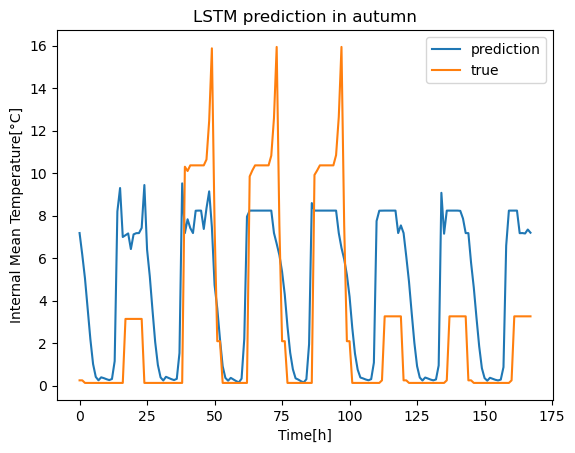

In [133]:
y_pred = np.array(y_pred)
y_pred = y_pred.reshape(-1)
plt.figure()
plt.plot(y_pred, label='prediction')
plt.plot(range(len(y_pred)),df.loc[7000:7168 -1, y_col_names], label='true')
plt.xlabel('Time[h]')
plt.ylabel('Internal Mean Temperature[°C]')
plt.legend()
plt.title('LSTM prediction in autumn')
plt.show()

In [134]:
y_pred.shape
y_real_winter = df.loc[7000:7168-1, y_col_names]
print(f'mse:{mse(y_real_winter, y_pred)}')

mse:15.386719766885795
